In [1]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import tweepy
#america 8-10 ET, quindi ET= UTC-5, quindi in america va dalle 1 alle 3 del 8 marzo
#orari interviste: UK: 21-23, USA: 1-3

In [3]:
data=pd.read_csv("C:/Users/aless/OneDrive/Desktop/AleBicocca/Data Science/Anno 2/Lab Economics/Vezzoli_psicology/progetto/Data_Dashboard/MH_completo.csv")

C:\Users\aless\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3058: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
data.columns

Index(['Unnamed: 0', 'created_at', 'id', 'id_str', 'text', 'retweeted_status',
       'retweet_count', 'user.id_str', 'user.screen_name', 'user.location',
       'lang', 'entities.hashtags', 'entities.user_mentions', 'coordinates'],
      dtype='object')

In [5]:
data=data[data['lang'] == 'en']  #si decide di analizzare esclusivamente tweet in lingua inglese, che rappresentano più del 90% del totale
data=data.drop('Unnamed: 0', axis=1)
data

,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions,coordinates
1,2021-03-08 23:59:53,1369075432314789891,1369075432314789891,Right I'm watching #MeghanAndHarry I'm on no-o...,None,0,2298249935,NasceraMahria,"Airdrie, Scotland",en,"[{'text': 'MeghanAndHarry', 'indices': [19, 34]}]",[],NaN
2,2021-03-08 23:59:51,1369075422886047744,1369075422886047744,RT @Iromg: What an absolute shower of shite th...,Status(_api=<tweepy.api.API object at 0x000002...,445,333389010,gettingoninyrs,Bridport Dorset,en,[],"[{'screen_name': 'Iromg', 'name': 'Mike Graham...",NaN
3,2021-03-08 23:59:51,1369075421204131842,1369075421204131842,RT @bashperkinsx: Harry had to witness his mot...,Status(_api=<tweepy.api.API object at 0x000002...,858,1107243349,fiandkaya,Wexford & London,en,[],"[{'screen_name': 'bashperkinsx', 'name': 'sash...",NaN
4,2021-03-08 23:59:47,1369075405722894337,1369075405722894337,So heartbreaking watching #MeghanAndHarry. I c...,None,0,148756213,BeckyFell,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [26, 41]}]",[],NaN
5,2021-03-08 23:59:46,1369075403193729030,1369075403193729030,Check out this article I wrote a year ago abou...,None,0,61175139,ericaarielfox,Upper West Side-NYC/Amsterdam,en,"[{'text': 'harryandmeghan', 'indices': [91, 10...",[],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95223,2021-03-08 00:00:40,1368713239966670848,1368713239966670848,RT @VeeFraz: Protect Meghan Markle at all cost...,Status(_api=<tweepy.api.API object at 0x000002...,56,2589736605,prwettistacy,United Kingdom,en,[],"[{'screen_name': 'VeeFraz', 'name': 'Vash', 'i...",NaN
95224,2021-03-08 00:00:29,1368713193871278082,1368713193871278082,RT @jameelajamil: You only ever work this hard...,Status(_api=<tweepy.api.API object at 0x000002...,252,501234691,ATrulyFan,España,en,"[{'text': 'MeghanAndHarry', 'indices': [86, 10...","[{'screen_name': 'jameelajamil', 'name': 'Jame...",NaN
95225,2021-03-08 00:00:27,1368713186057347079,1368713186057347079,BFD. The royal family and the press owe them a...,None,1,35445051,IamAlexRafael,"Queens, NY",en,"[{'text': 'MeghanMarkle', 'indices': [58, 71]}...",[],NaN
95226,2021-03-08 00:00:18,1368713146496598018,1368713146496598018,One hour to go until the #MeghanAndHarry inter...,None,1,991975703838183430,TrueRoyaltyTV,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [25, 40...",[],NaN


In [6]:
#si decide di creare 2 subset, uno riferito al tempo UTC in cui è andata in onda l'intervista in USA 
# il secondo riferito al tempo UTC in cui è andata in onda l'intervista in UK
#1 ora prima e una dopo per ognuna delle due interviste
uk=data[data['created_at'] > "2021-03-08 20:00:00"]
usa=data[data['created_at'] < "2021-03-08 04:00:00"]

In [7]:
len(uk)

16898

In [8]:
len(usa)

24134

In [8]:
#quanti sono i retweet?
uk[uk['retweeted_status'] != 'None'].count()  #più della metà sono retweet per uk

created_at                10003
id                        10003
id_str                    10003
text                      10003
retweeted_status          10003
retweet_count             10003
user.id_str               10003
user.screen_name          10003
user.location              6568
lang                      10003
entities.hashtags         10003
entities.user_mentions    10003
coordinates                   0
dtype: int64

In [9]:
usa[usa['retweeted_status'] != 'None'].count()  #la metà sono retweet per usa

created_at                12718
id                        12718
id_str                    12718
text                      12718
retweeted_status          12718
retweet_count             12718
user.id_str               12718
user.screen_name          12718
user.location              8878
lang                      12718
entities.hashtags         12718
entities.user_mentions    12718
coordinates                   0
dtype: int64

In [10]:
#può essere utile valutare quanti siano gli HUBS nelle due reti dei retweet, dato che sono tanti
#si costruiscono dunque le reti dei retweet

#retweet come atteggiamento più implicito del tweet stesso
#vediamo come la gente si comporta su twitter in questo senso

In [11]:
#UK con solo retweet per analisi di rete

retweets_uk=uk[uk['retweeted_status'] != 'None']  
retweets_uk=retweets_uk[['user.id_str','retweeted_status']]
retweets_uk

,user.id_str,retweeted_status
2,333389010,Status(_api=<tweepy.api.API object at 0x000002...
3,1107243349,Status(_api=<tweepy.api.API object at 0x000002...
6,1029906159883485186,Status(_api=<tweepy.api.API object at 0x000002...
7,268855367,Status(_api=<tweepy.api.API object at 0x000002...
8,884371624358797312,Status(_api=<tweepy.api.API object at 0x000002...
...,...,...
18786,3045401758,Status(_api=<tweepy.api.API object at 0x000002...
18789,334178844,Status(_api=<tweepy.api.API object at 0x000002...
18790,1117432803543658496,Status(_api=<tweepy.api.API object at 0x000002...
18791,902350622187507712,Status(_api=<tweepy.api.API object at 0x000002...


In [12]:
#in questo blocco di codice si cerca di estrarre dal campo retweeted_status l'id dell'utente del tweet retwettato
user_id_ret=[]
li=retweets_uk['retweeted_status'].values.tolist()
for el in li:
    mystring =  el
    keyword = '\'user\': {\'id\': '
    before_keyword, keyword, after_keyword = mystring.partition(keyword)
    ak=after_keyword
    keyword_2=','
    before_keyword_2, keyword_2, after_keyword_2 = ak.partition(keyword_2) 
    user_id_ret.append(before_keyword_2)

len(user_id_ret) 

10003

In [13]:
retweets_uk['user_id_ret']=user_id_ret
retweets_uk=retweets_uk.drop('retweeted_status',axis=1) 
retweets_uk=retweets_uk.groupby(retweets_uk.columns.tolist(),as_index=False).size().reset_index()
retweets_uk.columns=['user.id_str','user_id_ret','weight']
retweets_uk

,user.id_str,user_id_ret,weight
0,608583,832692898739036160,1
1,767858,554648712,1
2,1039121,16490235,1
3,2105021,227347152,1
4,3419141,832692898739036160,1
...,...,...,...
9572,1369024522452664321,293575749,1
9573,1369050507914993669,21042473,1
9574,1369052529749790721,1053014282466676736,1
9575,1369062059317620746,21042473,1


In [14]:
user_ret_network= nx.DiGraph()
for index,row in retweets_uk.iterrows():
    user_ret_network.add_edge(row['user.id_str'],row['user_id_ret'],weight=row['weight']) #costruiamo la network pesata
#il peso dipende dal numero di volte che un user retwetta un post di un altro user
#peso maggiore avvicina il nodo al nodo ritwittato piu volte

In [15]:
ret_id=list(retweets_uk['user.id_str'])
au=[]

for node in user_ret_network:
    if node not in ret_id:
        au.append(0) #no
    else:
        au.append(1) #yes

        
len(au)

#codice utile a capire chi non ha effettuato ritweet, venendo solo ritwittato di fatto (colore verde nel grafico)  

9653

In [16]:
color_map =[]
count=-1
for el in au:
    count+=1
    if au[count] == 0: #coloriamo di verde chi non ha effettuato ritweet
        color_map.append('blue')
    else:
        color_map.append('deepskyblue')
len(color_map)

9653

In [18]:
#rimportiamo le keys
#authentication in order to take screen names
consumer_key = 'vyKCYUP01f8WgcVtzg4XUOcBV'  
consumer_secret = 'FGG6Rvgftv5CGT4gQUS7v48GjWDh9Lni1wRUiKzVU94EoQ5w4h'
access_token = '1204688282115813376-XVNQKPcHyJSRiIbsFU56PoeYxhC3ZA'
access_secret = 'NUHgUDwdJDE2QN7TiWt2xO6SwMPfGvvyBELg8HKg2eyS7'

auth = tweepy.OAuthHandler(consumer_key, consumer_secret)
auth.set_access_token(access_token, access_secret)
api=tweepy.API(auth, wait_on_rate_limit=True, wait_on_rate_limit_notify=True)

In [18]:
#dizionario labels per grafico. cerchiamo gli screen name di coloro che hanno ottenuto piu di 150 retweet all'interno della rete
nodes_list= list(user_ret_network.nodes())
d=dict(user_ret_network.in_degree())
for key in d:
    if d[key]<150:
        d[key]=''
    else:
        u=api.get_user(key)
        d[key]=u.screen_name

In [19]:
node_big = []  #per ingrandire gli users che hanno ottenuto più di 50 retweet (influencer)
for node in user_ret_network:
    if user_ret_network.in_degree(node) >= 150:
        node_big.append(10000)
    else: 
        node_big.append(100)      
len(node_big)

9653

Name: 
Type: DiGraph
Number of nodes: 9653
Number of edges: 9577
Average in degree:   0.9921
Average out degree:   0.9921


C:\Users\aless\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
C:\Users\aless\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


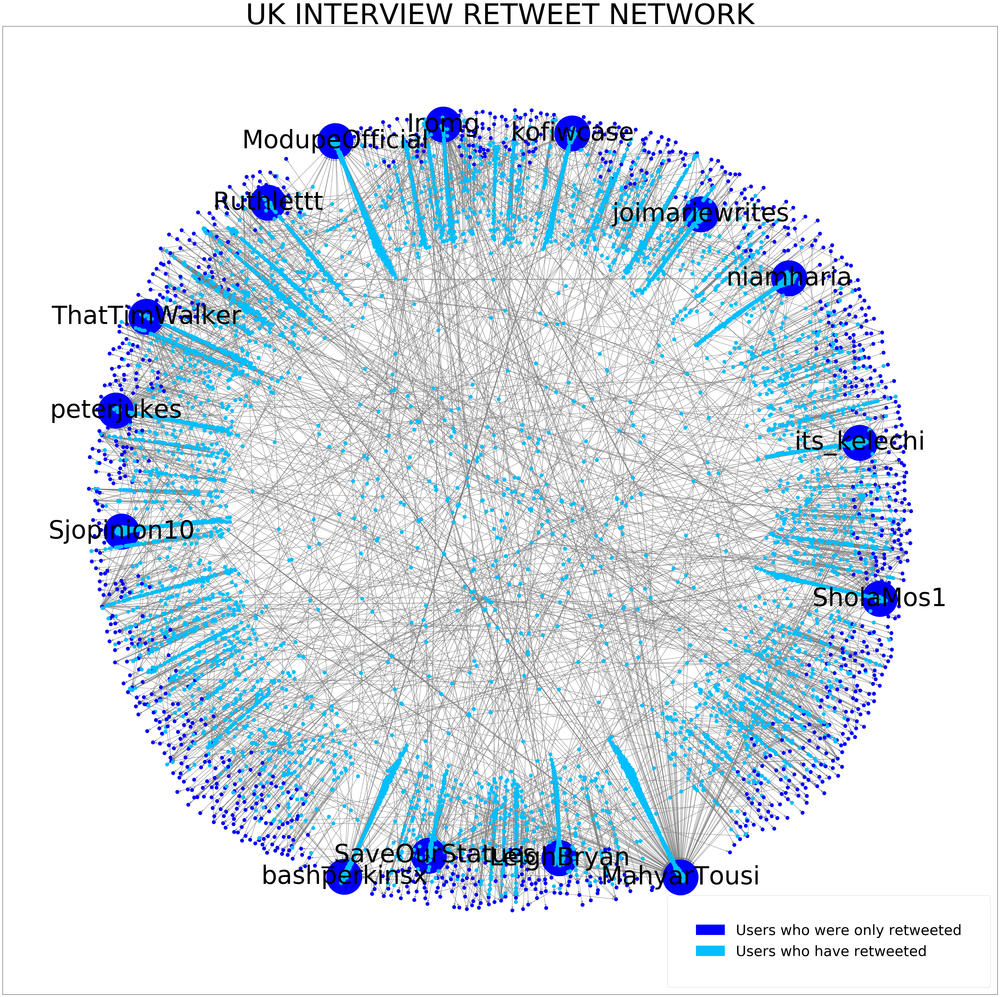

In [20]:
print(nx.info(user_ret_network)) #da qui estraiamo order e size e commento
plt.figure(figsize =(50,50), dpi=100)
plt.title('UK INTERVIEW RETWEET NETWORK', fontsize=80)
nx.draw_networkx(user_ret_network,with_labels=True, node_color=color_map, labels = d, font_size=70, node_size=node_big, edge_color='grey')

import matplotlib.patches as mpatches

green_patch = mpatches.Patch(color='blue', label='Users who were only retweeted')
yellow_patch = mpatches.Patch(color='deepskyblue', label='Users who have retweeted')
plt.legend(handles=[green_patch, yellow_patch], loc='lower right', borderpad=2,prop={'size':40})

In [21]:
#degree_centrality_in
#centr_degree sono normalizzate automaticamente

#cerchiamo chi sono i 10 con il grado piu alto di in_degree, per vedere dunque chi sono i piu ritwettati

from networkx import in_degree_centrality
in_deg=in_degree_centrality(user_ret_network)
in_deg_sort=dict(sorted(in_deg.items(), key=lambda item: item[1], reverse= True))
list_degin =list(in_deg_sort.values())[0:5] #ottengo i primi 10 valori 
list_degin=[round(num,3) for num in list_degin]

deg_in=sorted([user_ret_network.in_degree(n) for n in user_ret_network.nodes()])
deg_in=deg_in[-6:-1] #top 10 per retweet lista
deg_in=deg_in[::-1]


us=[]
hubs=[]
count=0
for key in in_deg_sort:  #ottengo gli screen name
    count+=1
    if count<6:
        hubs.append(key)
        u=api.get_user(key).screen_name
        us.append(u)

#unisco tutto in un dataframe

cen_deg_in=pd.DataFrame(list(zip(us, deg_in)), columns = ['user_screen_name','reetweets_got'])
cen_deg_in

,user_screen_name,reetweets_got
0,MahyarTousi,585
1,ModupeOfficial,434
2,bashperkinsx,362
3,niamharia,309
4,kofiwcase,293


In [22]:
#Tousi post a favore della regina
#moudupe tweet a favore di megan, razzismo
#bash tweet a favore di harry, da mediatore
#
#kofi, personaggio molto seguito su twitter, post sul razzismo, come moudupe

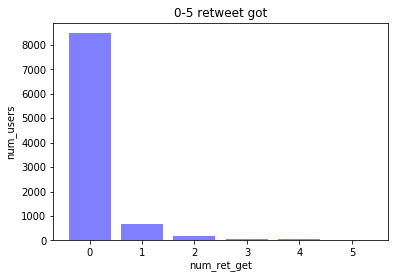

In [23]:
#behaviour of users in term of retweet
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees = sorted([user_ret_network.in_degree(n) for n in user_ret_network.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='blue')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_get')
plt.title('0-5 retweet got')
plt.show()



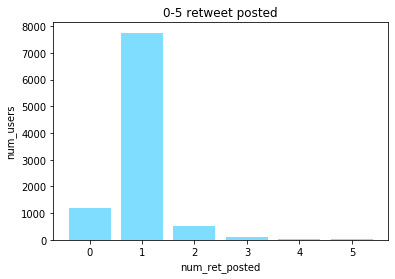

In [24]:
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees = sorted([user_ret_network.out_degree(n) for n in user_ret_network.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='deepskyblue')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_posted')
plt.title('0-5 retweet posted')
plt.show()

In [25]:
#USA

In [10]:
retweets_usa=usa[usa['retweeted_status'] != 'None']  
retweets_usa=retweets_usa[['user.id_str','retweeted_status']]
retweets_usa

,user.id_str,retweeted_status
70251,55936843,Status(_api=<tweepy.api.API object at 0x000002...
70252,19894711,Status(_api=<tweepy.api.API object at 0x000002...
70253,1174833368057466888,Status(_api=<tweepy.api.API object at 0x000002...
70254,1732746848,Status(_api=<tweepy.api.API object at 0x000002...
70255,396338840,Status(_api=<tweepy.api.API object at 0x000002...
...,...,...
95216,1295660745393307648,Status(_api=<tweepy.api.API object at 0x000002...
95218,601769381,Status(_api=<tweepy.api.API object at 0x000002...
95223,2589736605,Status(_api=<tweepy.api.API object at 0x000002...
95224,501234691,Status(_api=<tweepy.api.API object at 0x000002...


In [11]:
#in questo blocco di codice si cerca di estrarre dal campo retweeted_status l'id dell'utente del tweet retwettato
user_id_ret_usa=[]
li=retweets_usa['retweeted_status'].values.tolist()
for el in li:
    mystring =  el
    keyword = '\'user\': {\'id\': '
    before_keyword, keyword, after_keyword = mystring.partition(keyword)
    ak=after_keyword
    keyword_2=','
    before_keyword_2, keyword_2, after_keyword_2 = ak.partition(keyword_2) 
    user_id_ret_usa.append(before_keyword_2)

len(user_id_ret_usa) 

12718

In [12]:
retweets_usa['user_id_ret']=user_id_ret_usa
retweets_usa=retweets_usa.drop('retweeted_status',axis=1) 
retweets_usa=retweets_usa.groupby(retweets_usa.columns.tolist(),as_index=False).size().reset_index()
retweets_usa.columns=['user.id_str','user_id_ret','weight']
retweets_usa

,user.id_str,user_id_ret,weight
0,10221,48762460,1
1,23803,14425522,1
2,81383,197643621,1
3,619553,63363339,1
4,739933,17190011,1
...,...,...,...
11606,1368741875541155842,938446032039546880,1
11607,1368742982027984898,2808361752,1
11608,1368746508514955265,1025538004167864321,1
11609,1368759071113875458,1025538004167864321,1


In [13]:
user_ret_network_usa= nx.DiGraph()
for index,row in retweets_usa.iterrows():
    user_ret_network_usa.add_edge(row['user.id_str'],row['user_id_ret'],weight=row['weight']) #costruiamo la network pesata
#il peso dipende dal numero di volte che un user retwetta un post di un altro user
#peso maggiore avvicina il nodo al nodo ritwittato piu volte

In [14]:
ret_id_usa=list(retweets_usa['user.id_str'])
au_usa=[]

for node in user_ret_network_usa:
    if node not in ret_id_usa:
        au_usa.append(0) #no
    else:
        au_usa.append(1) #yes

        
len(au_usa)

#codice utile a capire chi non ha effettuato ritweet, venendo solo ritwittato di fatto (colore verde nel grafico)  

10342

In [15]:
color_map_usa =[]
count=-1
for el in au_usa:
    count+=1
    if au_usa[count] == 0: #coloriamo di verde chi non ha effettuato ritweet
        color_map_usa.append('red')
    else:
        color_map_usa.append('sandybrown')
len(color_map_usa)

10342

In [19]:
#dizionario labels per grafico. cerchiamo gli screen name di coloro che hanno ottenuto piu di 50 retweet all'interno della rete
nodes_list_usa= list(user_ret_network_usa.nodes())
d_usa=dict(user_ret_network_usa.in_degree())
for key in d_usa:
    if d_usa[key]<150:
        d_usa[key]=''
    else:
        u=api.get_user(key)
        d_usa[key]=u.screen_name

In [20]:
node_big_usa = []  #per ingrandire gli users che hanno ottenuto più di 50 retweet (influencer)
for node in user_ret_network_usa:
    if user_ret_network_usa.in_degree(node) >= 150:
        node_big_usa.append(10000)
    else: 
        node_big_usa.append(100)      
len(node_big_usa)

10342

Name: 
Type: DiGraph
Number of nodes: 10342
Number of edges: 11611
Average in degree:   1.1227
Average out degree:   1.1227


C:\Users\aless\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
C:\Users\aless\Anaconda3\lib\site-packages\networkx\drawing\nx_pylab.py:676: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if cb.iterable(node_size):  # many node sizes


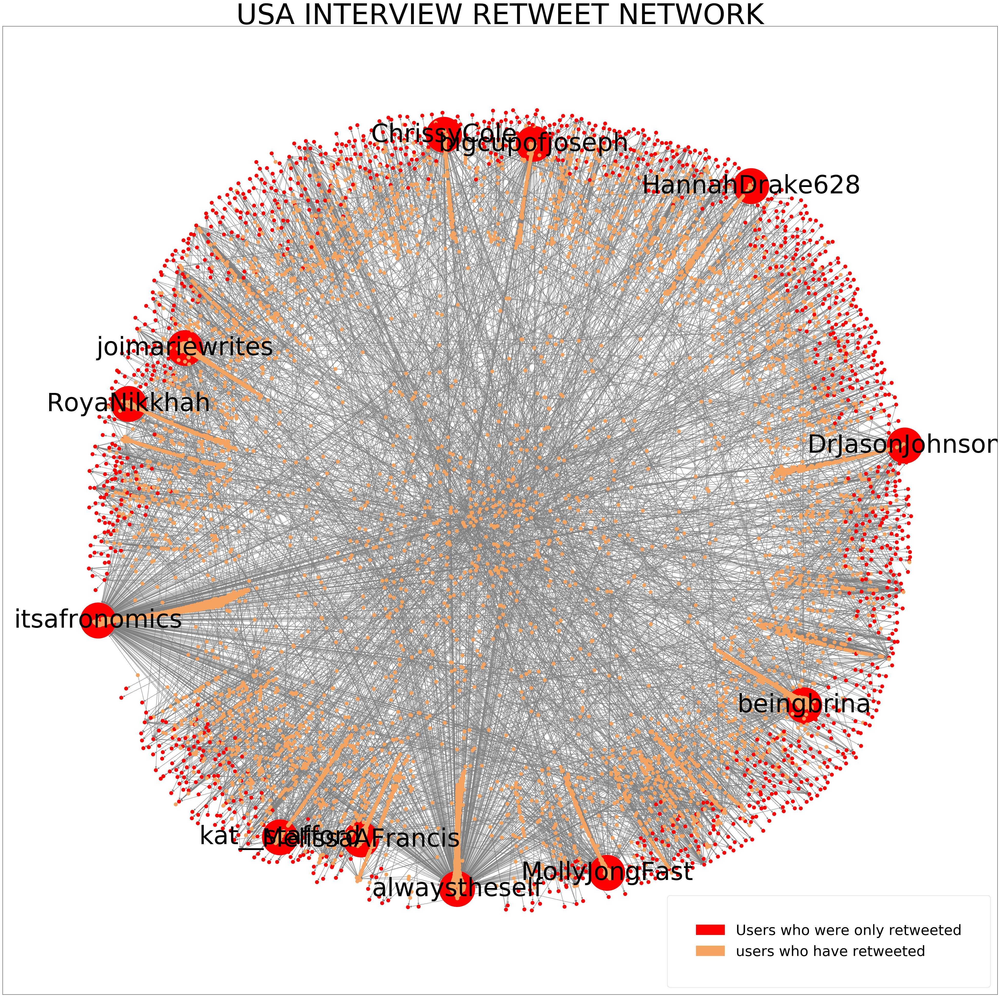

In [21]:
print(nx.info(user_ret_network_usa)) #da qui estraiamo order e size e commento
plt.figure(figsize =(50,50), dpi=100)
plt.title('USA INTERVIEW RETWEET NETWORK',fontsize=80)
nx.draw_networkx(user_ret_network_usa,with_labels=True, node_color=color_map_usa, labels = d_usa, font_size=70, node_size=node_big_usa, edge_color='grey')

import matplotlib.patches as mpatches

green_patch = mpatches.Patch(color='red', label='Users who were only retweeted')
yellow_patch = mpatches.Patch(color='sandybrown', label='users who have retweeted')
plt.legend(handles=[green_patch, yellow_patch], loc='lower right', borderpad=2,prop={'size':40})

In [35]:
#degree_centrality_in
#centr_degree sono normalizzate automaticamente

#cerchiamo chi sono i 10 con il grado piu alto di in_degree, per vedere dunque chi sono i piu ritwettati

from networkx import in_degree_centrality
in_deg_usa=in_degree_centrality(user_ret_network_usa)
in_deg_sort_usa=dict(sorted(in_deg_usa.items(), key=lambda item: item[1], reverse= True))
#list_degin =list(in_deg_sort.values())[0:5] #ottengo i primi 10 valori 
#list_degin=[round(num,3) for num in list_degin]

deg_in_usa=sorted([user_ret_network_usa.in_degree(n) for n in user_ret_network_usa.nodes()])
deg_in_usa=deg_in_usa[-6:-1] #top 10 per retweet lista
deg_in_usa=deg_in_usa[::-1]


us_usa=[]
hubs_usa=[]
count=0
for key in in_deg_sort_usa:  #ottengo gli screen name
    count+=1
    if count<6:
        hubs_usa.append(key)
        u=api.get_user(key).screen_name
        us_usa.append(u)

#unisco tutto in un dataframe

cen_deg_in_usa=pd.DataFrame(list(zip(us_usa, deg_in_usa)), columns = ['user_screen_name','reetweets_got'])
cen_deg_in_usa

,user_screen_name,reetweets_got
0,itsafronomics,1437
1,alwaystheself,558
2,beingbrina,433
3,joimariewrites,296
4,MollyJongFast,266


In [36]:
#1 razzismo
#2 razzismo
#3 razzismo, a favore di meghan
#4 razzismo
#5 

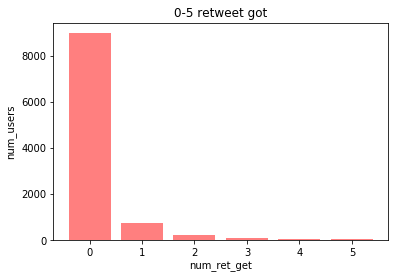

In [37]:
#behaviour of users in term of retweet
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees_usa = sorted([user_ret_network_usa.in_degree(n) for n in user_ret_network_usa.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees_usa:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='red')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_get')
plt.title('0-5 retweet got')
plt.show()

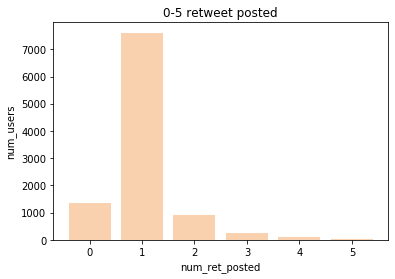

In [38]:
#produciamo un barchart per valutare quanti utenti hanno ricevuto pochi retweets, pari ad un numero minore di 5

objects = ('0','1','2','3','4','5')
degrees_usa = sorted([user_ret_network_usa.out_degree(n) for n in user_ret_network_usa.nodes()])

uno=0
due=0
tre=0
qua=0
cin=0
zer=0
for el in degrees_usa:
    if el == 0:
        zer+=1
    if el == 1:
        uno+=1
    if el == 2:
        due+=1
    if el == 3:
        tre+=1
    if el == 4:
        qua+=1
    if el == 5:
        cin+=1
        
performance=[]
performance.append(zer)
performance.append(uno)
performance.append(due)
performance.append(tre)
performance.append(qua)
performance.append(cin)

y_pos = np.arange(len(objects))
 
plt.bar(y_pos, performance, align='center', alpha=0.5, color='sandybrown')
plt.xticks(y_pos, objects)
plt.ylabel('num_users')
plt.xlabel('num_ret_posted')
plt.title('0-5 retweet posted')
plt.show()

In [39]:
#as we could think, behaviour in 2 networks is similar. This are particular caracteristic of a retweet network

In [40]:
#SENTIMENT ANALYSIS, EMOTION ANALYSIS and EMOTICON ANALYSIS

In [41]:
#PREPROCESSING

In [42]:
import nltk
#nltk.download('punkt')
#nltk.download('stopwords')
from nltk.tokenize import word_tokenize

In [43]:
tweets=data['text']
print(tweets.iloc[0])
print(word_tokenize(tweets.iloc[0]))  #example of tokenization not preprocessed

Right I'm watching #MeghanAndHarry I'm on no-one's side but at the start she mentioned that her Mum asked if Diana… https://t.co/7Lgpl0zJxa
['Right', 'I', "'m", 'watching', '#', 'MeghanAndHarry', 'I', "'m", 'on', 'no-one', "'s", 'side', 'but', 'at', 'the', 'start', 'she', 'mentioned', 'that', 'her', 'Mum', 'asked', 'if', 'Diana…', 'https', ':', '//t.co/7Lgpl0zJxa']


In [44]:
from nltk.tokenize import TweetTokenizer
tokening = TweetTokenizer()
tweets_tokenized = tweets.apply(tokening.tokenize)
tweets_tokenized

1        [Right, I'm, watching, #MeghanAndHarry, I'm, o...
2        [RT, @Iromg, :, What, an, absolute, shower, of...
3        [RT, @bashperkinsx, :, Harry, had, to, witness...
4        [So, heartbreaking, watching, #MeghanAndHarry,...
5        [Check, out, this, article, I, wrote, a, year,...
                               ...                        
95223    [RT, @VeeFraz, :, Protect, Meghan, Markle, at,...
95224    [RT, @jameelajamil, :, You, only, ever, work, ...
95225    [BFD, ., The, royal, family, and, the, press, ...
95226    [One, hour, to, go, until, the, #MeghanAndHarr...
95227    [RT, @UnRoyalReporter, :, Here, ’, s, the, fir...
Name: text, Length: 87916, dtype: object

In [45]:
from collections import Counter
import itertools

sentences = (list(itertools.chain(tweets_tokenized)))
flat_list = [item for sublist in sentences for item in sublist]
flat_list[:15]

['Right',
 "I'm",
 'watching',
 '#MeghanAndHarry',
 "I'm",
 'on',
 "no-one's",
 'side',
 'but',
 'at',
 'the',
 'start',
 'she',
 'mentioned',
 'that']

In [46]:
#STOPWORD


In [47]:
from nltk.corpus import stopwords
stop=stopwords.words('english')
li=['she','her','herself',"she's",'hers'] #we decide to keep these words because could be referred to meghan 
for el in li:
    stop.remove(el)
stop[:15]

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours']

In [48]:
def preprocess(tokenized_sentence):
    return [item for item in tokenized_sentence if item not in stop] #remove stopwords

tweets_tokenized_prep = tweets_tokenized.apply(preprocess)
tweets_tokenized_prep

1        [Right, I'm, watching, #MeghanAndHarry, I'm, n...
2        [RT, @Iromg, :, What, absolute, shower, shite,...
3        [RT, @bashperkinsx, :, Harry, witness, mother,...
4        [So, heartbreaking, watching, #MeghanAndHarry,...
5        [Check, article, I, wrote, year, ago, Harry, M...
                               ...                        
95223    [RT, @VeeFraz, :, Protect, Meghan, Markle, cos...
95224    [RT, @jameelajamil, :, You, ever, work, hard, ...
95225    [BFD, ., The, royal, family, press, owe, apolo...
95226    [One, hour, go, #MeghanAndHarry, interview, #O...
95227    [RT, @UnRoyalReporter, :, Here, ’, first, epis...
Name: text, Length: 87916, dtype: object

In [49]:
# Function to get the counter
def get_counter(df):
  sentences = (list(itertools.chain(df)))
  flat_list = [item for sublist in sentences for item in sublist]
  c = Counter(flat_list)
  return c

In [50]:
c = get_counter(tweets_tokenized_prep)
c.most_common(10) #in order to count most common word in our tweets

[(':', 64744),
 ('.', 59203),
 ('RT', 58785),
 ('…', 52621),
 ('#MeghanAndHarry', 48182),
 (',', 35517),
 ('!', 19593),
 ('’', 18658),
 ('#MeghanMarkle', 16370),
 ('I', 15775)]

In [51]:
import string
from nltk import wordpunct_tokenize

punctuation = string.punctuation[1:] # we decide to keep !, so we put 1 as starting value of the list
print(punctuation)

"#$%&'()*+,-./:;<=>?@[\]^_`{|}~


In [52]:
def preprocess(tokenized_sentence):
  tokenized_sentence_stop = [item.lower() for item in tokenized_sentence if item.lower() not in stop] #remove stopwords and lowercase
  return [item for item in tokenized_sentence_stop if item not in punctuation] #remove punctuation 

tweets_tokenized_prep = tweets_tokenized.apply(preprocess)
tweets_tokenized_prep

1        [right, i'm, watching, #meghanandharry, i'm, n...
2        [rt, @iromg, absolute, shower, shite, let, ’, ...
3        [rt, @bashperkinsx, harry, witness, mother, be...
4        [heartbreaking, watching, #meghanandharry, ’, ...
5        [check, article, wrote, year, ago, harry, megh...
                               ...                        
95223    [rt, @veefraz, protect, meghan, markle, cost, ...
95224    [rt, @jameelajamil, ever, work, hard, destroy,...
95225    [bfd, royal, family, press, owe, apology, !, 💯...
95226    [one, hour, go, #meghanandharry, interview, #o...
95227    [rt, @unroyalreporter, ’, first, episode, reca...
Name: text, Length: 87916, dtype: object

In [53]:
c = get_counter(tweets_tokenized_prep)
c.most_common(30)

[('rt', 58786),
 ('…', 52621),
 ('#meghanandharry', 49057),
 ('!', 19593),
 ('’', 18658),
 ('#meghanmarkle', 16434),
 ('she', 15438),
 ('meghan', 14846),
 ('right', 12291),
 ('harry', 10616),
 ('#piersmorgan', 10463),
 ('🏾', 10392),
 ('leave', 10299),
 ('👏', 10163),
 ('https://t.co…', 9745),
 ('#blacktwitter', 9668),
 ('@modupeofficial', 9612),
 ('#blackbritishtwitter', 9600),
 ('ima', 9598),
 ('watch', 8175),
 ('family', 7470),
 ('interview', 7443),
 ('her', 7047),
 ('royal', 6377),
 ('...', 6176),
 ('prince', 6166),
 ('get', 5853),
 ('woman', 5778),
 ('“', 5775),
 ('oprah', 5770)]

In [54]:
stop =set(stop)
#adding some of the stopwords after observing the tweets in ordere to clean 
stop.add("\x81")
stop.add("...")
stop.add("…")
stop.add("’")
stop.add("“")
stop.add("”")
stop.add("#meghanandharry")
stop.add("#meghanandharryonoprah")
stop.add("#oprahmeghanharry")
stop.add("https://t.co…")
stop.add("\x89")
stop.add("ĚĄ".lower())
stop.add("ă")
stop.add("\x9d")
stop.add("âÂĺ".lower())
stop.add("Ě".lower())
stop.add("˘")
stop.add("Â".lower())
stop.add("âÂ".lower())
stop.add("Ň")
stop.add("http")
stop.add("https")
stop.add("co")
stop.add("000")
stop.add("Ň".lower())
stop.add("Ň".lower())
stop.add("Ň".lower())

stop = list(stop)
print(stop)

['can', 'ââĺ', 'before', 'aren', 'under', 'we', 'â', 'his', 'having', '“', 'it', 'shan', 'when', 'with', 'here', 'couldn', "wouldn't", "you're", '\x81', 'he', 'who', '#meghanandharry', 'm', 'those', 'out', 'yourselves', 'what', 'this', 'ěą', 'that', 'further', 'hasn', 'mightn', 'how', 'did', '˘', 'an', 'both', 'where', 'doing', 'into', "mustn't", 'been', 't', "needn't", 'ain', 'd', '”', 'only', 'then', 'y', '000', 'won', "shan't", 'which', 'during', 'some', 'any', 'by', 'and', 'few', 'below', "that'll", 'just', 'him', 'nor', "it's", 'weren', 'ma', 'a', "weren't", 'were', 'have', 'the', 'should', 'am', 'too', 'your', '#meghanandharryonoprah', 'yours', 'haven', 'don', 'to', 'no', 'do', "didn't", 'their', 'over', 'until', 's', 'them', 'in', 'http', "hadn't", 'didn', '#oprahmeghanharry', 've', 'if', 'themselves', "won't", "doesn't", "shouldn't", 'between', 'myself', 'isn', 'shouldn', 'once', 'my', 'more', 'theirs', 'but', 'of', 'same', 'itself', '...', 'be', 'for', 'most', 'very', 'mustn',

In [55]:
def preprocess(tokenized_sentence, stopwords=[]):
  tokenized_sentence_stop = [item.lower() for item in tokenized_sentence if item.lower() not in set(stopwords)] #remove stopwords and lowercase
  return [item.lower() for item in tokenized_sentence_stop if item not in punctuation] #remove punctuation 


tweets_tokenized_prep = tweets_tokenized.apply(lambda x: preprocess(x, stopwords=stop))
c = get_counter(tweets_tokenized_prep)
c.most_common(30)

[('rt', 58786),
 ('!', 19593),
 ('#meghanmarkle', 16434),
 ('she', 15438),
 ('meghan', 14846),
 ('right', 12291),
 ('harry', 10616),
 ('#piersmorgan', 10463),
 ('🏾', 10392),
 ('leave', 10299),
 ('👏', 10163),
 ('#blacktwitter', 9668),
 ('@modupeofficial', 9612),
 ('#blackbritishtwitter', 9600),
 ('ima', 9598),
 ('watch', 8175),
 ('family', 7470),
 ('interview', 7443),
 ('her', 7047),
 ('royal', 6377),
 ('prince', 6166),
 ('get', 5853),
 ('woman', 5778),
 ('oprah', 5770),
 ('@itsafronomics', 5315),
 ('diana', 5312),
 ('like', 4806),
 ('people', 4711),
 ('watching', 4633),
 ('archie', 4478)]

In [56]:
from nltk.stem import WordNetLemmatizer 
#nltk.download('wordnet')
lemmatizer = WordNetLemmatizer()   #we decide to lemmatize our words


def preprocess(tokenized_sentence, stopwords=[]):
  tokenized_sentence_stop = [item.lower() for item in tokenized_sentence if item.lower() not in set(stopwords)] #remove stopwords and lowercase
  x = [item.lower() for item in tokenized_sentence_stop if item not in punctuation] #remove punctuation 
  return [lemmatizer.lemmatize(item) for item in x]


tweets_tokenized_prep = tweets_tokenized.apply(lambda x: preprocess(x, stopwords=stop))
c = get_counter(tweets_tokenized_prep)
c.most_common(30)


[('rt', 58786),
 ('!', 19593),
 ('#meghanmarkle', 16434),
 ('she', 15438),
 ('meghan', 14846),
 ('right', 12315),
 ('harry', 10616),
 ('#piersmorgan', 10463),
 ('🏾', 10392),
 ('leave', 10299),
 ('👏', 10163),
 ('#blacktwitter', 9668),
 ('@modupeofficial', 9612),
 ('#blackbritishtwitter', 9600),
 ('ima', 9598),
 ('watch', 8194),
 ('woman', 7773),
 ('family', 7551),
 ('interview', 7549),
 ('royal', 7511),
 ('her', 7047),
 ('prince', 6198),
 ('get', 5999),
 ('oprah', 5770),
 ('say', 5422),
 ('diana', 5323),
 ('@itsafronomics', 5315),
 ('like', 4939),
 ('people', 4726),
 ('watching', 4633)]

In [57]:
tweets_tokenized_prep

1        [right, i'm, watching, i'm, no-one's, side, st...
2        [rt, @iromg, absolute, shower, shite, let, str...
3        [rt, @bashperkinsx, harry, witness, mother, be...
4        [heartbreaking, watching, even, begin, imagine...
5        [check, article, wrote, year, ago, harry, megh...
                               ...                        
95223    [rt, @veefraz, protect, meghan, markle, cost, ...
95224    [rt, @jameelajamil, ever, work, hard, destroy,...
95225    [bfd, royal, family, press, owe, apology, !, 💯...
95226    [one, hour, go, interview, #oprah, ready, miss...
95227    [rt, @unroyalreporter, first, episode, recap, ...
Name: text, Length: 87916, dtype: object

In [58]:
data['tweet_preprocessed'] = tweets_tokenized_prep
data['tweet_preprocessed']  #we add a column of lists to our dataframe

1        [right, i'm, watching, i'm, no-one's, side, st...
2        [rt, @iromg, absolute, shower, shite, let, str...
3        [rt, @bashperkinsx, harry, witness, mother, be...
4        [heartbreaking, watching, even, begin, imagine...
5        [check, article, wrote, year, ago, harry, megh...
                               ...                        
95223    [rt, @veefraz, protect, meghan, markle, cost, ...
95224    [rt, @jameelajamil, ever, work, hard, destroy,...
95225    [bfd, royal, family, press, owe, apology, !, 💯...
95226    [one, hour, go, interview, #oprah, ready, miss...
95227    [rt, @unroyalreporter, first, episode, recap, ...
Name: tweet_preprocessed, Length: 87916, dtype: object

In [59]:
data   #we can see new variable

,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions,coordinates,tweet_preprocessed
1,2021-03-08 23:59:53,1369075432314789891,1369075432314789891,Right I'm watching #MeghanAndHarry I'm on no-o...,None,0,2298249935,NasceraMahria,"Airdrie, Scotland",en,"[{'text': 'MeghanAndHarry', 'indices': [19, 34]}]",[],NaN,"[right, i'm, watching, i'm, no-one's, side, st..."
2,2021-03-08 23:59:51,1369075422886047744,1369075422886047744,RT @Iromg: What an absolute shower of shite th...,Status(_api=<tweepy.api.API object at 0x000002...,445,333389010,gettingoninyrs,Bridport Dorset,en,[],"[{'screen_name': 'Iromg', 'name': 'Mike Graham...",NaN,"[rt, @iromg, absolute, shower, shite, let, str..."
3,2021-03-08 23:59:51,1369075421204131842,1369075421204131842,RT @bashperkinsx: Harry had to witness his mot...,Status(_api=<tweepy.api.API object at 0x000002...,858,1107243349,fiandkaya,Wexford & London,en,[],"[{'screen_name': 'bashperkinsx', 'name': 'sash...",NaN,"[rt, @bashperkinsx, harry, witness, mother, be..."
4,2021-03-08 23:59:47,1369075405722894337,1369075405722894337,So heartbreaking watching #MeghanAndHarry. I c...,None,0,148756213,BeckyFell,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [26, 41]}]",[],NaN,"[heartbreaking, watching, even, begin, imagine..."
5,2021-03-08 23:59:46,1369075403193729030,1369075403193729030,Check out this article I wrote a year ago abou...,None,0,61175139,ericaarielfox,Upper West Side-NYC/Amsterdam,en,"[{'text': 'harryandmeghan', 'indices': [91, 10...",[],NaN,"[check, article, wrote, year, ago, harry, megh..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95223,2021-03-08 00:00:40,1368713239966670848,1368713239966670848,RT @VeeFraz: Protect Meghan Markle at all cost...,Status(_api=<tweepy.api.API object at 0x000002...,56,2589736605,prwettistacy,United Kingdom,en,[],"[{'screen_name': 'VeeFraz', 'name': 'Vash', 'i...",NaN,"[rt, @veefraz, protect, meghan, markle, cost, ..."
95224,2021-03-08 00:00:29,1368713193871278082,1368713193871278082,RT @jameelajamil: You only ever work this hard...,Status(_api=<tweepy.api.API object at 0x000002...,252,501234691,ATrulyFan,España,en,"[{'text': 'MeghanAndHarry', 'indices': [86, 10...","[{'screen_name': 'jameelajamil', 'name': 'Jame...",NaN,"[rt, @jameelajamil, ever, work, hard, destroy,..."
95225,2021-03-08 00:00:27,1368713186057347079,1368713186057347079,BFD. The royal family and the press owe them a...,None,1,35445051,IamAlexRafael,"Queens, NY",en,"[{'text': 'MeghanMarkle', 'indices': [58, 71]}...",[],NaN,"[bfd, royal, family, press, owe, apology, !, 💯..."
95226,2021-03-08 00:00:18,1368713146496598018,1368713146496598018,One hour to go until the #MeghanAndHarry inter...,None,1,991975703838183430,TrueRoyaltyTV,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [25, 40...",[],NaN,"[one, hour, go, interview, #oprah, ready, miss..."


In [60]:
# ricostruisco le stringhe da i token
clean_text =[]
for index,row in data.iterrows():
    phrase_string =""    
    for word in row['tweet_preprocessed']:
        phrase_string = phrase_string+word+" "
    clean_text.append(phrase_string)    
data['clean_text'] = clean_text
data

,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions,coordinates,tweet_preprocessed,clean_text
1,2021-03-08 23:59:53,1369075432314789891,1369075432314789891,Right I'm watching #MeghanAndHarry I'm on no-o...,None,0,2298249935,NasceraMahria,"Airdrie, Scotland",en,"[{'text': 'MeghanAndHarry', 'indices': [19, 34]}]",[],NaN,"[right, i'm, watching, i'm, no-one's, side, st...",right i'm watching i'm no-one's side start she...
2,2021-03-08 23:59:51,1369075422886047744,1369075422886047744,RT @Iromg: What an absolute shower of shite th...,Status(_api=<tweepy.api.API object at 0x000002...,445,333389010,gettingoninyrs,Bridport Dorset,en,[],"[{'screen_name': 'Iromg', 'name': 'Mike Graham...",NaN,"[rt, @iromg, absolute, shower, shite, let, str...",rt @iromg absolute shower shite let strip titl...
3,2021-03-08 23:59:51,1369075421204131842,1369075421204131842,RT @bashperkinsx: Harry had to witness his mot...,Status(_api=<tweepy.api.API object at 0x000002...,858,1107243349,fiandkaya,Wexford & London,en,[],"[{'screen_name': 'bashperkinsx', 'name': 'sash...",NaN,"[rt, @bashperkinsx, harry, witness, mother, be...",rt @bashperkinsx harry witness mother belittle...
4,2021-03-08 23:59:47,1369075405722894337,1369075405722894337,So heartbreaking watching #MeghanAndHarry. I c...,None,0,148756213,BeckyFell,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [26, 41]}]",[],NaN,"[heartbreaking, watching, even, begin, imagine...",heartbreaking watching even begin imagine http...
5,2021-03-08 23:59:46,1369075403193729030,1369075403193729030,Check out this article I wrote a year ago abou...,None,0,61175139,ericaarielfox,Upper West Side-NYC/Amsterdam,en,"[{'text': 'harryandmeghan', 'indices': [91, 10...",[],NaN,"[check, article, wrote, year, ago, harry, megh...",check article wrote year ago harry meghan true...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95223,2021-03-08 00:00:40,1368713239966670848,1368713239966670848,RT @VeeFraz: Protect Meghan Markle at all cost...,Status(_api=<tweepy.api.API object at 0x000002...,56,2589736605,prwettistacy,United Kingdom,en,[],"[{'screen_name': 'VeeFraz', 'name': 'Vash', 'i...",NaN,"[rt, @veefraz, protect, meghan, markle, cost, ...",rt @veefraz protect meghan markle cost fuck pa...
95224,2021-03-08 00:00:29,1368713193871278082,1368713193871278082,RT @jameelajamil: You only ever work this hard...,Status(_api=<tweepy.api.API object at 0x000002...,252,501234691,ATrulyFan,España,en,"[{'text': 'MeghanAndHarry', 'indices': [86, 10...","[{'screen_name': 'jameelajamil', 'name': 'Jame...",NaN,"[rt, @jameelajamil, ever, work, hard, destroy,...",rt @jameelajamil ever work hard destroy someth...
95225,2021-03-08 00:00:27,1368713186057347079,1368713186057347079,BFD. The royal family and the press owe them a...,None,1,35445051,IamAlexRafael,"Queens, NY",en,"[{'text': 'MeghanMarkle', 'indices': [58, 71]}...",[],NaN,"[bfd, royal, family, press, owe, apology, !, 💯...",bfd royal family press owe apology ! 💯 #meghan...
95226,2021-03-08 00:00:18,1368713146496598018,1368713146496598018,One hour to go until the #MeghanAndHarry inter...,None,1,991975703838183430,TrueRoyaltyTV,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [25, 40...",[],NaN,"[one, hour, go, interview, #oprah, ready, miss...",one hour go interview #oprah ready miss first ...


In [61]:
#si decide di creare 2 subset, uno riferito al tempo UTC in cui è andata in onda l'intervista in USA 
# il secondo riferito al tempo UTC in cui è andata in onda l'intervista in UK
#1 ora prima e una dopo per ognuna delle due interviste
uk_clean=data[data['created_at'] > "2021-03-08 20:00:00"]
usa_clean=data[data['created_at'] < "2021-03-08 04:00:00"]

In [62]:
#sentiment

#confronto su meghan tra le due interviste: meghan, #megahmarkle, megxit ,her ecc...   OPINIONE SU MEGHAN
#razzismo: #black..., blackskin, #Archie     AMBIGUITà SUL TEMA
#oprah . harrhy


#word cloud statici pre e post interviste
#word cloud interattivo durante intervista

#sia ritweet che non


In [63]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk
#nltk.download('vader_lexicon')

# analyzer di VADER
Analyzer = SentimentIntensityAnalyzer()

In [64]:
# si mostra la differenza tra un testo lemmatizzato e preprocessato e un testo non processato

display(data['text'].iloc[15000])
display(Analyzer.polarity_scores(data['text'].iloc[15000]))

display(data['clean_text'].iloc[15000])
display(Analyzer.polarity_scores(data['clean_text'].iloc[15000]))

'When Meghan compared herself to Ariel losing her voice 🥺🥺🥺 #MeghanAndHarry'

{'neg': 0.206, 'neu': 0.794, 'pos': 0.0, 'compound': -0.3818}

'meghan compared herself ariel losing her voice 🥺 🥺 🥺 '

{'neg': 0.302, 'neu': 0.698, 'pos': 0.0, 'compound': -0.3818}

In [65]:
# ritorna polarity media relativa al subset
# compound e' valore normalizzato di VADER (-1,+1)
import math
def sentiment_subset(subset):
    compounds = []
    compound_sum = 0
    positives = 0
    negatives = 0
    neutrals = 0
    
    for index,row in subset.iterrows():
        diz_sentiment = Analyzer.polarity_scores(row['clean_text'])
        if diz_sentiment['compound'] >= 0.05:
            positives+=1
        if diz_sentiment['compound'] <= -0.05:
            negatives+=1
        else:
            neutrals+=1
        compounds.append(diz_sentiment['compound'])
        compound_sum+= diz_sentiment['compound']
        
    compound_mean = compound_sum / len(subset)
    compound_stdev = np.std(compounds)
    lower=compound_mean-1.64*compound_stdev/(math.sqrt(positives+negatives+neutrals)) #intervallo normale
    upper=compound_mean+1.64*compound_stdev/(math.sqrt(positives+negatives+neutrals))
    scarto = 1.64*compound_stdev/(math.sqrt(positives+negatives+neutrals))
    confint=(round(lower,3),round(upper,3))
    return compound_mean,scarto,confint

In [66]:
# prende in input un dataset ed una lista di hastags (filtri usati per la sentiment) restituisce subset
def subset_filtro(dataset_input,filtri):
    dataset=dataset_input.copy()
    dataset = dataset.reset_index()
    for index,row in dataset.iterrows():
        if not any(x in row['tweet_preprocessed'] for x in filtri):
            dataset.drop(index,inplace=True)
    return dataset 

In [67]:
#we start from analysis about Meghan

In [68]:
tags_meghan= ['meghan', '#megahmarkle', 'megxit' ,'her', '#meghan']    #we search these words in our tweets
meghan_usa=subset_filtro(usa_clean,tags_meghan)
meghan_uk=subset_filtro(uk_clean,tags_meghan)


In [69]:
len(meghan_usa)

6789

In [70]:
len(meghan_uk)

3806

In [71]:
#emotion analysis

In [72]:
#!pip install NRCLex

In [73]:
from nrclex import NRCLex


In [74]:
def get_emotions(sentence):    #function in order to extract emotion from words
  text_object = NRCLex(sentence)
  return text_object.raw_emotion_scores

In [75]:
def diz_emotions(subset):
    diz_emotion={}
    pos_neg=['positive','negative']
    for index,row in subset.iterrows():
        text_emotion=get_emotions(row['clean_text'])
        for key in text_emotion:
            if key not in pos_neg:
                if key not in diz_emotion:
                    diz_emotion[key]=text_emotion[key]
                else:
                    diz_emotion[key]+=text_emotion[key]
    return dict(sorted(diz_emotion.items(),key=lambda item: item[1]))
        


In [76]:
def get_percent_list(d):  
    lk=[]
    lv=[]
    s = sum(d.values())
    for k, v in d.items():
        pct = round(v * 100.0 / s,2)
        lk.append(k)
        lv.append(pct)

    percentile_list = pd.DataFrame({'emotion': lk,'perc': lv,})
    return percentile_list


In [77]:
# funzione che dato un subset, restituisce copia del subset senza retweets
def remove_retweets(subset_input):
    subset = subset_input.copy()
    for index,row in subset.iterrows():
        if row['retweeted_status'] != 'None':
            subset.drop(index,inplace=True) 
            
    return subset

In [78]:
meg_usa_noret=remove_retweets(meghan_usa)
len(meg_usa_noret)

2547

In [79]:
sentiment_subset(meg_usa_noret)

(0.02615865724381614, 0.013058181565971556, (0.013, 0.039))

In [80]:
sentiment_subset(meghan_usa)

(-0.016841110620120597, 0.008204286987445419, (-0.025, -0.009))

In [81]:
#sembra che eliminando i retweet, per la maggior parte inneggianti al razzismo, il punteggio sale in quanto...

In [82]:
meg_uk_noret=remove_retweets(meghan_uk)
len(meg_uk_noret)

1600

In [83]:
sentiment_subset(meg_uk_noret)   #sembra che gli influencer utilizzino parole forti

(0.032140187499999945, 0.016280554308585098, (0.016, 0.048))

In [84]:
sentiment_subset(meghan_uk)

(-0.07576526537046774, 0.009915785321939596, (-0.086, -0.066))

In [85]:
#barchart

In [86]:
meg_compounds = [sentiment_subset(meghan_usa)[0],sentiment_subset(meghan_uk)[0]]
meg_scarti = [sentiment_subset(meghan_usa)[1],sentiment_subset(meghan_uk)[1]]

print(meg_compounds)
print(meg_scarti)

meg_compounds_noretweets = [sentiment_subset(meg_usa_noret)[0],sentiment_subset(meg_uk_noret)[0]]
meg_scarti_noretweets = [sentiment_subset(meg_usa_noret)[1],sentiment_subset(meg_uk_noret)[1]]

print(meg_compounds_noretweets)
print(meg_scarti_noretweets)

[-0.016841110620120597, -0.07576526537046774]
[0.008204286987445419, 0.009915785321939596]
[0.02615865724381614, 0.032140187499999945]
[0.013058181565971556, 0.016280554308585098]


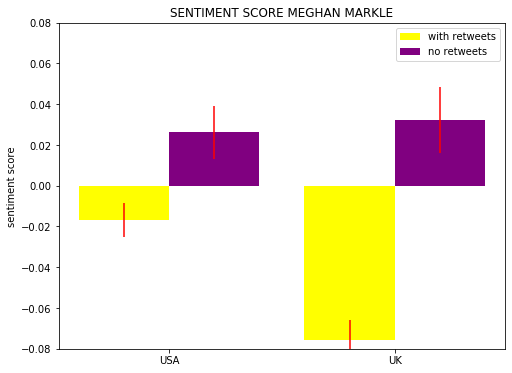

In [87]:
objects = ('USA','UK')

y_pos = np.arange(len(objects))
width = 0.40
fig, ax = plt.subplots(figsize=(8,6))
rects1 = ax.bar(y_pos - width/2,meg_compounds,width,label='with retweets',yerr=meg_scarti,color='yellow',ecolor="red")
rects2 = ax.bar(y_pos + width/2,meg_compounds_noretweets,width,label='no retweets',yerr=meg_scarti_noretweets,color='purple',ecolor="red")

ax.set_ylabel('sentiment score')
ax.set_title('SENTIMENT SCORE MEGHAN MARKLE')
ax.set_xticks(y_pos)
ax.set_xticklabels(objects)
ax.legend()
axes = plt.gca()
#axes.set_xlim([xmin,xmax])
axes.set_ylim([-0.08,0.08])

plt.show()

In [88]:
#emotion
muk_pie=get_percent_list(diz_emotions(meg_uk_noret))

In [89]:
muk_pie=muk_pie.set_index('emotion')

Text(0, 0.5, '')

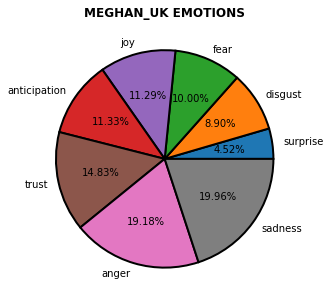

In [90]:
plot_uk=muk_pie.plot.pie(y='perc',figsize=(5,5),autopct='%.2f%%',wedgeprops={"edgecolor":"k",'linewidth': 2, 'antialiased': True},colors=['tab:blue',
'tab:orange',
'tab:green',
'tab:purple',
'tab:red',
'tab:brown',
'tab:pink',
'tab:gray'])
plot_uk.get_legend().remove()
plt.title('MEGHAN_UK EMOTIONS',weight='bold')
plt.ylabel('')

In [91]:
musa_pie=get_percent_list(diz_emotions(meg_usa_noret))
musa_pie=musa_pie.set_index('emotion')

Text(0, 0.5, '')

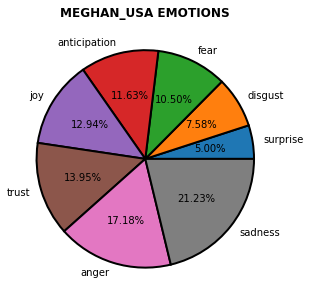

In [92]:
plot_usa=musa_pie.plot.pie(y='perc',figsize=(5,5),autopct='%.2f%%',wedgeprops={"edgecolor":"k",'linewidth': 2, 'antialiased': True})
plot_usa.get_legend().remove()
plt.title('MEGHAN_USA EMOTIONS',weight='bold')
plt.ylabel('')

In [93]:
#razzismo analisi

In [94]:
#senza retweet

In [95]:
#razzismo completo

In [96]:
tags_racism= ['#blackbritishtwitter', '#blacklivesmatter', 'black' ,'archie', 'skin', 'racism','racist']    #we search these words in our tweets
racism=subset_filtro(data,tags_racism)
len(racism)

21227

In [97]:
len(racism)

21227

In [98]:
sentiment_subset(racism)   #con retweet

(-0.14190700994018196, 0.0034625921907250833, (-0.145, -0.138))

In [99]:
racism_noret=remove_retweets(racism)   #senza ret
len(racism_noret)

3296

In [100]:
sentiment_subset(racism_noret)

(-0.2457683859223296, 0.012256241434380257, (-0.258, -0.234))

In [101]:
racism_compounds = [sentiment_subset(racism)[0]]
racism_scarti = [sentiment_subset(racism)[1]]

print(racism_compounds)
print(racism_scarti)

racism_compounds_noretweets = [sentiment_subset(racism_noret)[0]]
racism_scarti_noretweets = [sentiment_subset(racism_noret)[1]]

print(racism_compounds_noretweets)
print(racism_scarti_noretweets)

[-0.14190700994018196]
[0.0034625921907250833]
[-0.2457683859223296]
[0.012256241434380257]


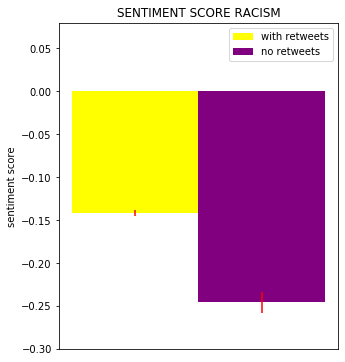

In [102]:
objects = ('RACISM')

y_pos = 1
width = 0.20
fig, ax = plt.subplots(figsize=(5,6))
rects1 = ax.bar(y_pos - width/2,racism_compounds,width=[0.2],label='with retweets',yerr=racism_scarti,color='yellow',ecolor="red")
rects2 = ax.bar(y_pos + width/2,racism_compounds_noretweets,width=[0.2],label='no retweets',yerr=racism_scarti_noretweets,color='purple',ecolor="red")

ax.set_ylabel('sentiment score')
ax.set_title('SENTIMENT SCORE RACISM')
ax.set_ylim([-0.3,0.08])
#ax.set_xlim('')
ax.legend()
ax.xaxis.set_visible(False)



#plt.bar(labels, values, width=[1, 0.5, 1, 0.5, 0.5]
plt.show()

In [103]:
#emotion racism

In [104]:
rac_pie=get_percent_list(diz_emotions(racism_noret))
rac_pie=rac_pie.set_index('emotion')

Text(0, 0.5, '')

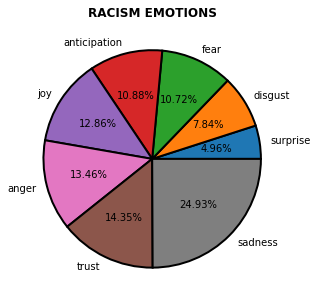

In [133]:
plot_rac=rac_pie.plot.pie(y='perc',figsize=(5,5),autopct='%.2f%%',wedgeprops={"edgecolor":"k",'linewidth': 2, 'antialiased': True},colors=['tab:blue',
'tab:orange',
'tab:green',
'tab:red',
'tab:purple',
'tab:pink',
'tab:brown',
'tab:gray'])
plot_rac.get_legend().remove()
plt.title('RACISM EMOTIONS',weight='bold')
plt.ylabel('')

In [106]:
#ESTRAGGO I DATASET PER I CLOUDWORD

In [107]:
data_noret=remove_retweets(data)

In [108]:
cw_uk=data_noret[(data_noret['created_at'] >= "2021-03-08 21:00:00") & (data_noret['created_at']<="2021-03-08 23:00:00")]
cw_usa=data_noret[(data_noret['created_at'] >= "2021-03-08 01:00:00") & (data_noret['created_at']<="2021-03-08 03:00:00")]
cw_uk=cw_uk[['created_at','tweet_preprocessed','clean_text']]
cw_usa=cw_usa[['created_at','tweet_preprocessed','clean_text']]
len(data_noret)

29156

In [109]:
cw_uk.to_csv("cw_uk_def",sep=';')
cw_usa.to_csv("cw_usa_def",sep=';')

In [110]:
#extracting data for area chart

In [111]:
pos=[]
neg=[]
neu=[]

for index,row in data.iterrows():
        diz_sentiment = Analyzer.polarity_scores(row['clean_text'])
        if diz_sentiment['compound'] >= 0.05:
            pos.append(1)
            neg.append(0)
            neu.append(0)
        elif diz_sentiment['compound'] <= -0.05:
            pos.append(0)
            neg.append(1)
            neu.append(0)
        else:
            pos.append(0)
            neg.append(0)
            neu.append(1)

In [112]:
MHSent=pd.DataFrame(list(zip(data['created_at'],pos, neu, neg)),
              columns=['Created At','positivi', 'negativi','neutrali'])

In [113]:
MHSent.to_csv('MHSent.csv')

In [114]:
#EMOJI ANALYSIS

In [115]:
# -*- coding: utf-8 -*-
import emoji
import re

text = """
Of course, too many emoji characters \
😊 like 😏, #@^!*&#@^# 🤕 helps 🐯 people read 😂aa😂aaa😂a💯 #douchebag
"""


text = emoji.demojize(text)
text = re.findall(r'(:[^:]*:)', text)
list_emoji = [emoji.emojize(x) for x in text]
print(list_emoji)


['😊', '😏', '🤕', '🐯', '😂', '😂', '😂', '💯']


In [116]:
emo_list=[]
for index,row in data_noret.iterrows():
    text = emoji.demojize(row['clean_text'])
    text = re.findall(r'(:[^:]*:)', text)
    list_emoji = [emoji.emojize(x) for x in text]
    emo_list.append(list_emoji)
emo_list

[[],
 [],
 [],
 ['://t.co/qdxz8py6ja… https:'],
 [],
 [],
 [],
 [],
 [],
 ['😂'],
 [],
 [],
 ['\U0001f971', '🤔'],
 [],
 [],
 ['💜'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['://t.co/lnkm6ftjex https:'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['🤦', '♂'],
 [],
 [],
 [],
 [],
 [],
 [],
 ['://t.co/ejx7dmeedy… https:'],
 ['🙄', '🙄'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['👗'],
 [],
 ['🤣'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['👏', '👋', '👏', '👏', '👏'],
 [],
 [],
 [],
 ['😑'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['👏', '🏽'],
 [],
 [],
 [],
 ['👇', '👇', '👇'],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 [],
 ['❤'],
 [],
 [],
 ['👉', '🏻', '://t.co/bbj8kjjlk0 :', ': :', ': https:', '👉', '🏻'],
 [],
 [],
 [],
 [],
 [],
 

In [117]:
data_noret['emoji'] = emo_list

data_noret

,created_at,id,id_str,text,retweeted_status,retweet_count,user.id_str,user.screen_name,user.location,lang,entities.hashtags,entities.user_mentions,coordinates,tweet_preprocessed,clean_text,emoji
1,2021-03-08 23:59:53,1369075432314789891,1369075432314789891,Right I'm watching #MeghanAndHarry I'm on no-o...,None,0,2298249935,NasceraMahria,"Airdrie, Scotland",en,"[{'text': 'MeghanAndHarry', 'indices': [19, 34]}]",[],NaN,"[right, i'm, watching, i'm, no-one's, side, st...",right i'm watching i'm no-one's side start she...,[]
4,2021-03-08 23:59:47,1369075405722894337,1369075405722894337,So heartbreaking watching #MeghanAndHarry. I c...,None,0,148756213,BeckyFell,NaN,en,"[{'text': 'MeghanAndHarry', 'indices': [26, 41]}]",[],NaN,"[heartbreaking, watching, even, begin, imagine...",heartbreaking watching even begin imagine http...,[]
5,2021-03-08 23:59:46,1369075403193729030,1369075403193729030,Check out this article I wrote a year ago abou...,None,0,61175139,ericaarielfox,Upper West Side-NYC/Amsterdam,en,"[{'text': 'harryandmeghan', 'indices': [91, 10...",[],NaN,"[check, article, wrote, year, ago, harry, megh...",check article wrote year ago harry meghan true...,[]
10,2021-03-08 23:59:40,1369075374022397956,1369075374022397956,Tennis star Serena Williams expresses support ...,None,0,80104835,freddie1999,England,en,[],[],NaN,"[tennis, star, serena, williams, express, supp...",tennis star serena williams express support me...,[://t.co/qdxz8py6ja… https:]
15,2021-03-08 23:59:33,1369075347761881088,1369075347761881088,@bbceastenders @f10aye @EricTrump @jacquelineM...,None,0,1710743832,ChuckSanddown,somewhere definitely not Windsors,en,[],"[{'screen_name': 'bbceastenders', 'name': 'BBC...",NaN,"[@bbceastenders, @f10aye, @erictrump, @jacquel...",@bbceastenders @f10aye @erictrump @jacquelinem...,[]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95220,2021-03-08 00:01:11,1368713368350162947,1368713368350162947,@Bethenny @Oprah I was going to record then wa...,None,0,433890626,MayaRyanN10,NaN,en,[],"[{'screen_name': 'Bethenny', 'name': 'Bethenny...",NaN,"[@bethenny, @oprah, going, record, watch, late...",@bethenny @oprah going record watch later than...,[]
95221,2021-03-08 00:00:59,1368713318635089923,1368713318635089923,Almost time for privacy loving couple to give ...,None,1,276781146,Shirleyccr,U.K.,en,[],[],NaN,"[almost, time, privacy, loving, couple, give, ...",almost time privacy loving couple give global ...,[]
95222,2021-03-08 00:00:45,1368713261600882689,1368713261600882689,1 hour! #MeghanAndHarry,None,0,992105480,kaydotkay,D(M)V,en,"[{'text': 'MeghanAndHarry', 'indices': [8, 23]}]",[],NaN,"[1, hour, !]",1 hour !,[]
95225,2021-03-08 00:00:27,1368713186057347079,1368713186057347079,BFD. The royal family and the press owe them a...,None,1,35445051,IamAlexRafael,"Queens, NY",en,"[{'text': 'MeghanMarkle', 'indices': [58, 71]}...",[],NaN,"[bfd, royal, family, press, owe, apology, !, 💯...",bfd royal family press owe apology ! 💯 #meghan...,[💯]


In [118]:
emo_uk=data_noret[(data_noret['created_at'] >= "2021-03-08 21:00:00") & (data_noret['created_at']<="2021-03-08 23:00:00")]
emo_usa=data_noret[(data_noret['created_at'] >= "2021-03-08 01:00:00") & (data_noret['created_at']<="2021-03-08 03:00:00")]

In [119]:
diz_uk={}
for index,row in emo_uk.iterrows():
    if len(row['emoji'])!=0:
        for emo in row['emoji']:
            if emo not in diz_uk:
                diz_uk[emo]=1
            else:
                diz_uk[emo]+=1
diz_uk=dict(sorted(diz_uk.items(), key=lambda item: item[1]))
diz_uk

{'://t.co/phmx8siwzr… https:': 1,
 '💭': 1,
 '✍': 1,
 '://t.co/hotqt7notn @bbceastenders @f10aye @erictrump https:': 1,
 '😶': 1,
 '://t.co/ypa4mednhq https:': 1,
 '://t.co/9key0l0yov https:': 1,
 '🤫': 1,
 '://t.co/phdwismnyk… https:': 1,
 '://t.co/cz2jv418x1 via @ukchange https:': 1,
 '👌': 1,
 '🏆': 1,
 '💍': 1,
 '😧': 1,
 '🍻': 1,
 '📷': 1,
 '💞': 1,
 '🥊': 1,
 '😞': 1,
 '⤵': 1,
 '🥇': 1,
 '💛': 1,
 '://t.co/guvnlp2vz7… https:': 1,
 '🙊': 1,
 '👉': 1,
 '👈': 1,
 '😑': 1,
 '🥚': 1,
 '🍳': 1,
 '://t.co/8akjyfcr8w… https:': 1,
 '💤': 1,
 '://t.co/fk3gxsprbz .   ... link #meghan https:': 1,
 '🏌': 1,
 '://t.co/0urmy0izak #meghanmarkle https:': 1,
 '://t.co/y0oaeopdhk via @youtube https:': 1,
 '🦎': 1,
 '://t.co/fk3gxsprbz link 🇬 🇧 🇺 🇸 https:': 1,
 '\U0001f90e': 1,
 '👨': 1,
 '🦰': 1,
 '💽': 1,
 '🍆': 1,
 '😎': 1,
 '://t.co/czvymiltlp #meghan https:': 1,
 '🤪': 1,
 '🏰': 1,
 '☝': 1,
 '🚌': 1,
 '👎': 1,
 '💌': 1,
 '😲': 1,
 '://t.co/5qucrq2kyi via @youtube https:': 1,
 '😣': 1,
 '://t.co/s1ydidkapw… https:': 1,
 '://t.co/

In [120]:
df_emo_uk = pd.DataFrame(list(diz_uk.items()),columns = ['Emoji','Frequency'])   #scegli gli items che vuoi tenere

In [121]:
df_emo_uk[220:226]

,Emoji,Frequency
220,🏻,37
221,😭,39
222,👀,40
223,❤,45
224,🤔,58
225,🤣,68


In [122]:
print(df_emo_uk['Frequency'].sum())
print(len(emo_uk))

#si riscontra un tweet con emoji ogni 4 circa durante l'intervista uk

1264
5010


(20, 80)

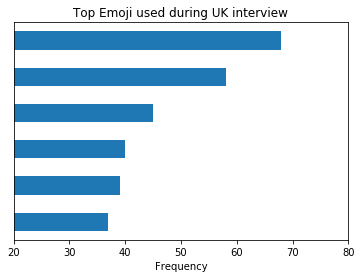

In [123]:

bar_uk=df_emo_uk[220:226].plot.barh(y="Frequency", x="Emoji", title="Top Emoji used during UK interview")
bar_uk.get_legend().remove()
plt.xlabel('Frequency')
plt.ylabel('')
plt.yticks([])
plt.xlim(20,80)


In [124]:
diz_usa={}
for index,row in emo_usa.iterrows():
    if len(row['emoji'])!=0:
        for emo in row['emoji']:
            if emo not in diz_usa:
                diz_usa[emo]=1
            else:
                diz_usa[emo]+=1
diz_usa=dict(sorted(diz_usa.items(), key=lambda item: item[1]))
diz_usa

{'🕊': 1,
 '🤴': 1,
 '🥧': 1,
 '⬇': 1,
 '🌈': 1,
 '😉': 1,
 '://t.co/ijdgyoyhbd via @youtube https:': 1,
 '\U0001fa78': 1,
 '♾': 1,
 '://t.co/0jshkid9wh https:': 1,
 '✍': 1,
 '💇': 1,
 '://t.co/89lk3xwr26 via @youtube https:': 1,
 '://t.co/ikzpxwbocn https:': 1,
 '👹': 1,
 '💛': 1,
 '👎': 1,
 ':00 uk sure many institution watching intervie https:': 1,
 ':30 wide awake went bed super early b https:': 1,
 '😓': 1,
 '🍝': 1,
 '☠': 1,
 '://t.co/81by9sz5ks https:': 1,
 '🛍': 1,
 '://t.co/rvyeti15wv #meghanmarkle https:': 1,
 '🤟': 1,
 ':30 west right #damnspoilers https:': 1,
 '🧿': 1,
 '://t.co/gshczqphhc https:': 1,
 '😰': 1,
 ':24 https:': 1,
 '☎': 1,
 '💁': 1,
 '🤚': 1,
 '🍕': 1,
 '🦋': 1,
 '☹': 1,
 '🤫': 1,
 "://t.co/ykqantier1's girl ! :": 1,
 ': 2.kate made meghan cry 3.the https:': 1,
 '👐': 1,
 '🎈': 1,
 '👺': 1,
 '👨': 1,
 '👦': 1,
 '🌎': 1,
 '😚': 1,
 '😋': 1,
 '🐍': 1,
 '://t.co/vu2hqmqo4j #harryandmeghanonoprah #spotify #spotifypodcasts @spotify https:': 1,
 '📷': 1,
 '://t.co/aiyzi1llrk https:': 1,
 '💻': 1

In [125]:
df_emo_usa = pd.DataFrame(list(diz_usa.items()),columns = ['Emoji','Frequency']) #seleziona items

In [126]:
#barplot

In [131]:
df_emo_usa.loc[226:231]

,Emoji,Frequency
226,❤,82
227,🥺,91
228,🏾,94
229,👏,104
230,😂,104
231,😭,185


In [128]:
print(df_emo_usa['Frequency'].sum())
print(len(emo_usa))

#si riscontra un tweet con emoji ogni 4 circa durante l'intervista uk6

2228
9607


(30, 220)

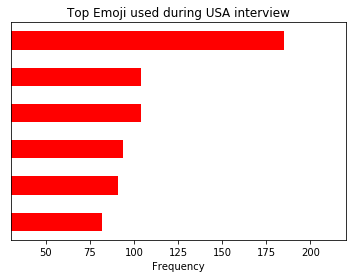

In [130]:
bar_usa=df_emo_usa[226:232].plot.barh(y="Frequency", x="Emoji", title="Top Emoji used during USA interview",color='red')
bar_usa.get_legend().remove()
plt.xlabel('Frequency')
plt.ylabel('')
plt.yticks([])
plt.xlim(30,220)